In [193]:
import cv2
import numpy as np
import pandas as pd
from google.colab import files


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


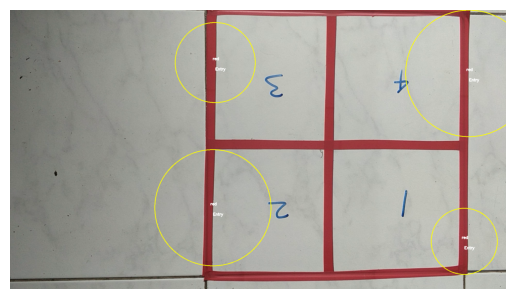

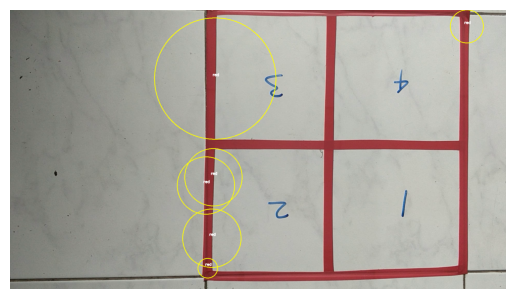

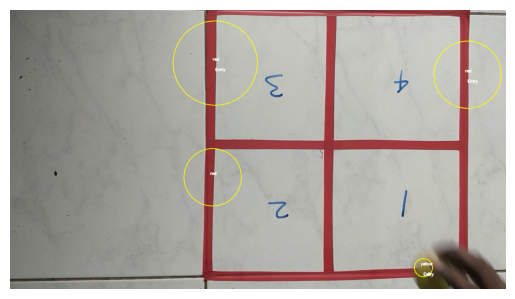

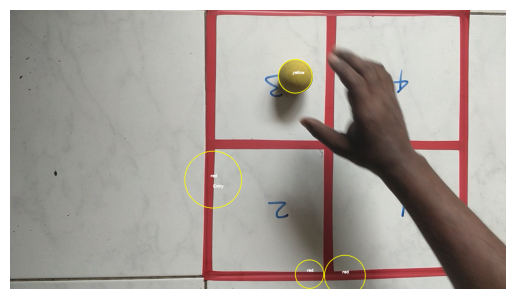

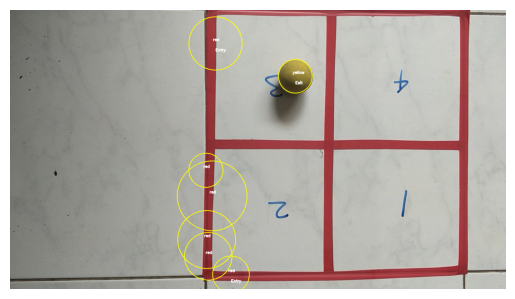

...

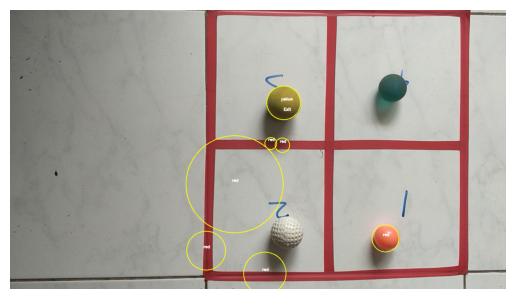

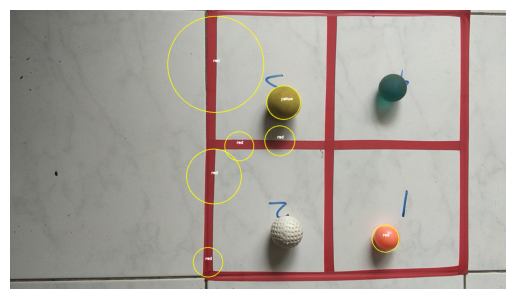

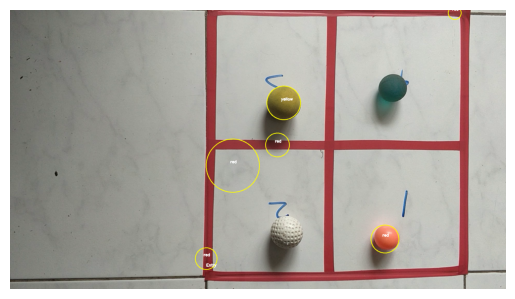

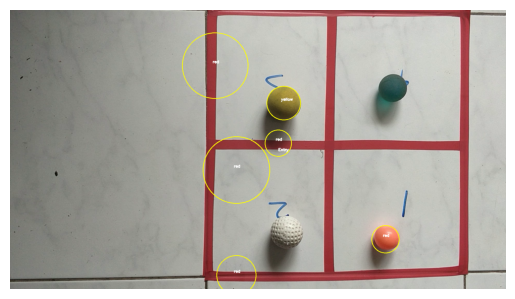

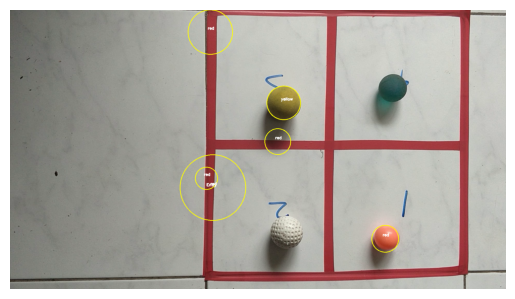

In [194]:
import cv2
import matplotlib.pyplot as plt
import os

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Read video from file
video_path = '/content/drive/MyDrive/Computer Vision/AI Assignment video.mp4'
output_dir = '/content/drive/MyDrive/Computer Vision/'
output_video_path = os.path.join(output_dir, 'processed_video.avi')
output_text_path = os.path.join(output_dir, 'events.txt')

# Ensure the output directory exists
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Function to detect balls and their colors
def detect_balls(frame):
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    masks = {
        'red': cv2.inRange(hsv, np.array([0, 120, 70]), np.array([10, 255, 255])),
        'blue': cv2.inRange(hsv, np.array([110, 50, 50]), np.array([130, 255, 255])),
        'green': cv2.inRange(hsv, np.array([50, 100, 100]), np.array([70, 255, 255])),
        'yellow': cv2.inRange(hsv, np.array([20, 100, 100]), np.array([30, 255, 255]))
    }

    balls = []
    for color, mask in masks.items():
        contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        for contour in contours:
            if cv2.contourArea(contour) > 500:  # Adjust size filter as needed
                (x, y), radius = cv2.minEnclosingCircle(contour)
                if radius > 10:  # Adjust size filter as needed
                    balls.append((color, int(x), int(y), int(radius)))
    return balls

# Function to determine quadrant
def get_quadrant(x, y, width, height):
    if x < width // 2 and y < height // 2:
        return 1
    elif x >= width // 2 and y < height // 2:
        return 2
    elif x < width // 2 and y >= height // 2:
        return 3
    else:
        return 4

# Function to track ball movements and save events
def track_balls(video_path, output_video_path, output_text_path):
    cap = cv2.VideoCapture(video_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)

    # If fps is zero, set it to a default value (e.g., 30)
    if fps == 0:
        fps = 30
        print("FPS value is zero. Setting default FPS to 30.")

    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

    ball_positions = {}
    events = []
    frame_number = 0

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        balls = detect_balls(frame)
        timestamp = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000.0

        for color, x, y, radius in balls:
            quadrant = get_quadrant(x, y, width, height)
            cv2.circle(frame, (x, y), radius, (0, 255, 255), 2)
            cv2.putText(frame, f"{color}", (x - 10, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

            if (color, quadrant) not in ball_positions:
                ball_positions[(color, quadrant)] = 'inside'
                events.append((timestamp, quadrant, color, 'Entry'))
                cv2.putText(frame, "Entry", (x, y + 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
            elif ball_positions[(color, quadrant)] == 'outside':
                ball_positions[(color, quadrant)] = 'inside'
                events.append((timestamp, quadrant, color, 'Entry'))
                cv2.putText(frame, "Entry", (x, y + 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

        for (color, quadrant), status in ball_positions.items():
            if status == 'inside' and (color, quadrant) not in [(c, get_quadrant(x, y, width, height)) for c, x, y, r in balls]:
                ball_positions[(color, quadrant)] = 'outside'
                events.append((timestamp, quadrant, color, 'Exit'))
                cv2.putText(frame, "Exit", (x, y + 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

        # Optionally, display the frame using matplotlib (for Google Colab)
        if frame_number % int(fps) == 0:
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            plt.imshow(frame_rgb)
            plt.axis('off')  # Hide the axis
            plt.show()

        out.write(frame)
        frame_number += 1

    cap.release()
    out.release()

    with open(output_text_path, 'w') as f:
        f.write('Time, Quadrant Number, Ball Colour, Type\n')
        for event in events:
            f.write(f'{event[0]}, {event[1]}, {event[2]}, {event[3]}\n')

# Process the video
track_balls(video_path, output_video_path, output_text_path)
